In [1]:
import layoutparser as lp
import cv2

In [2]:
imagee = cv2.imread('/Users/bprk/Downloads/Epaper_14_2024-12-29_15.jpeg')

In [3]:
pip install jpeg

ERROR: Could not find a version that satisfies the requirement jpeg (from versions: none)
ERROR: No matching distribution found for jpeg
Note: you may need to restart the kernel to use updated packages.


In [4]:
model = lp.Detectron2LayoutModel(
    config_path = "/Users/bprk/Downloads/config.yaml",
    model_path = "/Users/bprk/Downloads/model_0039999.pth",
    extra_config = ["MODEL.ROI_HEADS.SCORE_THRESH_TEST", 0.8] # <-- Only output high accuracy preds
)

/Users/bprk/anaconda3/envs/matenv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/Users/bprk/anaconda3/envs/matenv/lib/python3.12/site-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.seri

In [5]:
layout = model.detect(imagee)

/Users/bprk/anaconda3/envs/matenv/lib/python3.12/site-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/aten/src/ATen/native/TensorShape.cpp:3596.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


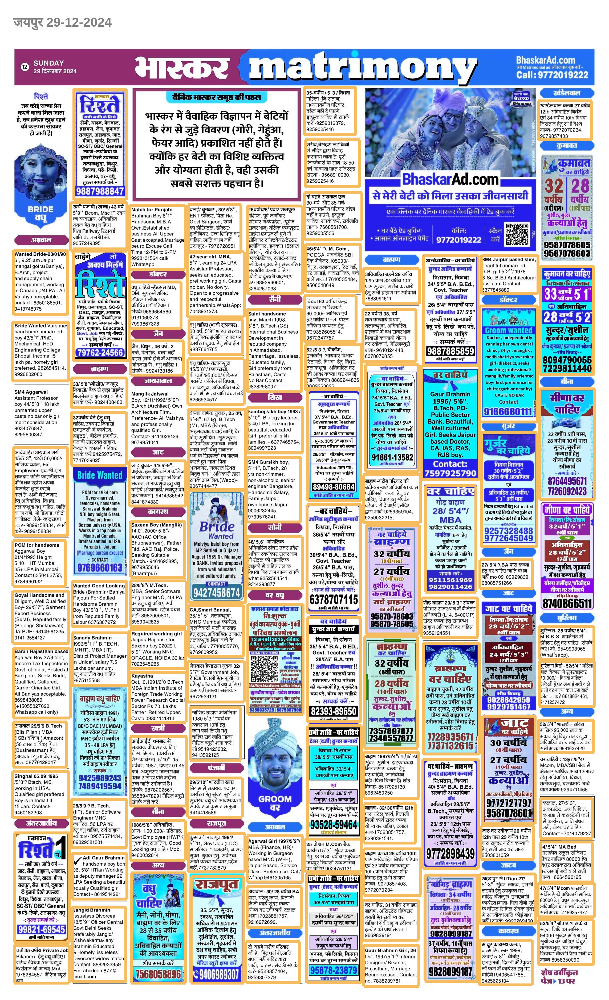

In [6]:
lp.draw_box(imagee, layout)

In [7]:
type(layout)

layoutparser.elements.layout.Layout

In [8]:
layout[0]

TextBlock(block=Rectangle(x_1=2019.169189453125, y_1=3312.328125, x_2=2231.007080078125, y_2=3438.082763671875), text=None, id=None, type=0, parent=None, next=None, score=0.9998519420623779)

In [9]:
text_blocks = lp.Layout([b for b in layout if b.type==0])
figure_blocks = lp.Layout([b for b in layout if b.type=='Figure'])

In [10]:
h, w = imagee.shape[:2]

left_interval = lp.Interval(0, w/2*1.05, axis='x').put_on_canvas(imagee)

left_blocks = text_blocks.filter_by(left_interval, center=True)
left_blocks.sort(key = lambda b:b.coordinates[1], inplace=True)
# The b.coordinates[1] corresponds to the y coordinate of the region
# sort based on that can simulate the top-to-bottom reading order 
right_blocks = lp.Layout([b for b in text_blocks if b not in left_blocks])
right_blocks.sort(key = lambda b:b.coordinates[1], inplace=True)

# And finally combine the two lists and add the index
text_blocks = lp.Layout([b.set(id = idx) for idx, b in enumerate(left_blocks + right_blocks)])

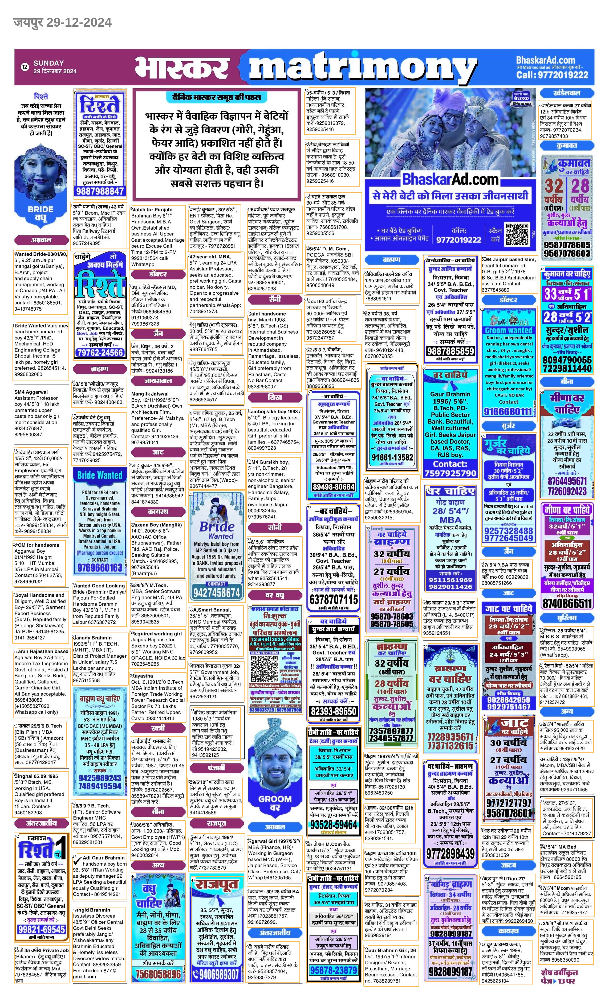

In [11]:
lp.draw_box(imagee, text_blocks,
            box_width=3, 
            show_element_id=True)

In [13]:
pip install pytesseract

Note: you may need to restart the kernel to use updated packages.


In [14]:
import layoutparser.ocr as ocr
ocr_agent = ocr.TesseractAgent(languages="eng+hin")

In [15]:
for block in text_blocks:
    segment_image = (block
                       .pad(left=5, right=5, top=5, bottom=5)
                       .crop_image(imagee))
    lp.draw_box(segment_image, text_blocks,
            box_width=3, 
            show_element_id=True)
        # add padding in each image segment can help
        # improve robustness 
        
    text = ocr_agent.detect(segment_image)
    block.set(text=text, inplace=True)

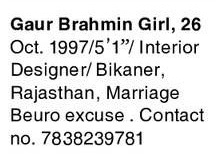

In [16]:
lp.draw_box(segment_image, text_blocks,
            box_width=3, 
            show_element_id=True)

In [17]:
for txt in text_blocks.get_texts():
    print(txt, end='\n---\n')

सैनी, यादव, मेघवाल,
ब्राह्मण, जैन, कुमावत,
राजपूत, अग्रवाल, जाट,
मीणा, गुर्जर, सिन्‍्धी
SC-ST/ OBC/ General
-लडकियों
हजारों रिश्ते sa
तलाकशुदा, विधुर,
अनपढ, वर-वधु
तुरन्त सम्पर्क करें:-

---
खत्री पंजाबी (खन्ना) 43 वर्ष
59“ Bcom, Msc IT स्वंय
का व्यवसाय, अविवाहित
खिवक, हेतु वधु चाहिए।
Railway रिटायर्ड।
जाति बंधन नहीं। मो.
9057249395

---
aes) ,30/5’8”,
ENT Sez, पिता Re.
Govt Surgeon, स्वयं

का हॉस्पिटल, डॉक्टर/
इंजीनियर, उच्च शिक्षित वधू
चाहिए, जाति बंधन नहीं,
उदयपुर - 7976728951

---
Match for Punjabi
Brahman Boy 617
Handsome M.B.A

Own, Established
business. All Upper
Cast excepted. Marriage
beuro Excuse Call
Time 12-PM to 2-PM
9928131564 call/
WhatsApp


---
26वर्षीय/6? पवार राजपूत/
वशिष्ठ, पूर्व जमींदार
परिवार मध्यप्रदेश, (पूर्वज
राजस्थान) बीटेक कम्प्यूटर
साइंस एमएनसी पुणे में
सीनियर सॉफ्टवेयर/टेस्टर
इंजीनियर, इनकम 15लाख
प्रतिवर्ष, प्योर वेज व नान
एल्कोहलिक, स्मार्ट-साफ्ट
स्पोकेन युवक हेतु संस्कारित-
सजातीय कन्या चाहिए।
फोटो व कुंडली वाट्सएप
पर- 9893960601,
6264267038

---
सभी जाति

In [18]:
import pickle
file = open('mat_model.pkl','wb')
pickle.dump(model,file)
